## Data

In [1]:
import numpy as np
import pandas as pd
import math
import seaborn as sb
from pylab import rcParams 
from numpy import genfromtxt

In [2]:
#Main file
file = 'Skin_NonSkin.txt';

X = pd.read_csv(file, sep='\t')
X.columns = ['blue', 'green', 'red', 'skin']
X.head()

,blue,green,red,skin
0,73,84,122,1
1,72,83,121,1
2,70,81,119,1
3,70,81,119,1
4,69,80,118,1


## Pairwise plot

In [3]:
#Presets for print, figures
%matplotlib inline
rcParams['figure.figsize']=5, 4
sb.set_style('whitegrid')

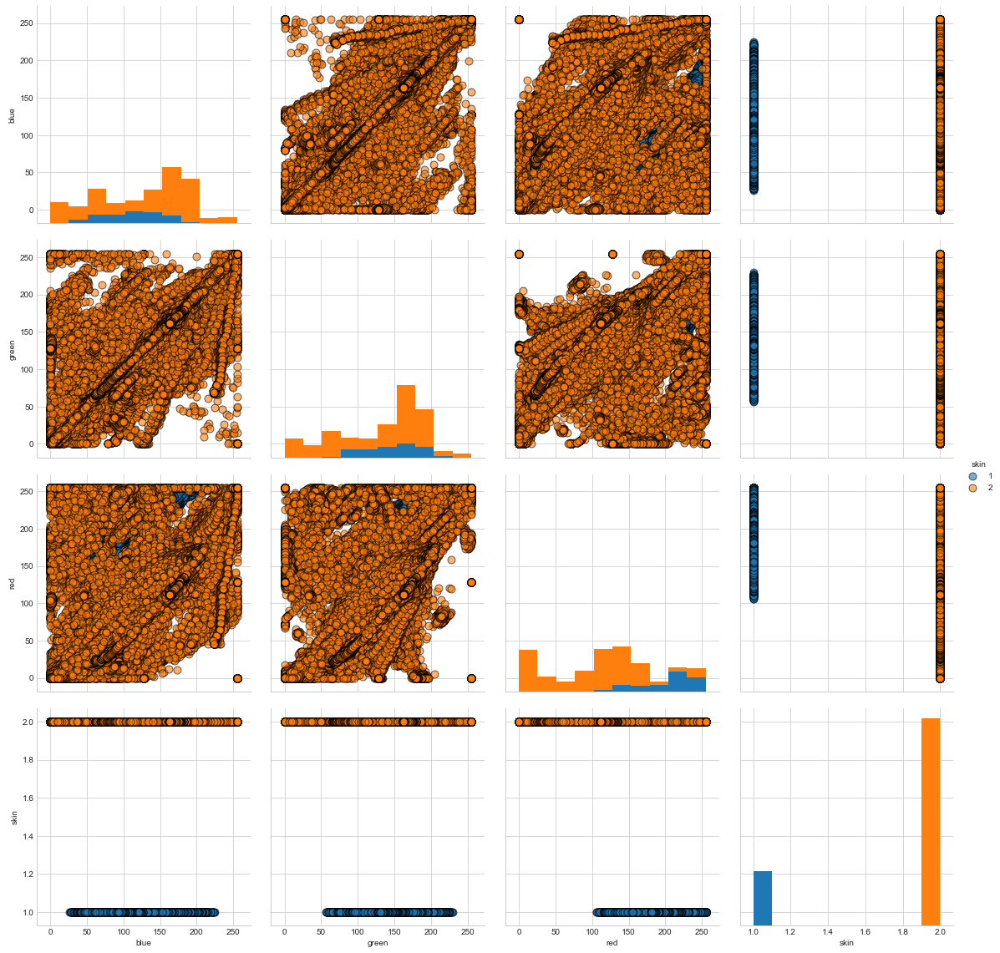

In [4]:
#Pairwise plot
sb.pairplot(X, hue = 'skin',
             plot_kws = {'alpha': 0.6, 's': 80, 'edgecolor': 'k'},
             size = 4)

## Scatter plot

In [6]:
#Dataset plot
import plotly as py
import plotly.graph_objs as go

trace1 = go.Scatter3d(
    x=X['blue'],
    y=X['green'],
    z=X['red'],
    text=['Red', 'Green', 'Blue'],
    showlegend=True,
    name='Skin',
    mode='markers',
    marker=dict(
        size=1,
        color=X['skin'],                # set color to an array/list of desired values
        colorscale='Viridis',   # choose a colorscale
        opacity=1
    )
)

data = [trace1]

layout = go.Layout(
    title='Skin(purp) vs Non skin(yellow)',
    scene = dict(
        xaxis = dict(
            title='Red'),
        yaxis = dict(
            title='Green'),
        zaxis = dict(
            title='Blue'),),
)

fig = go.Figure(data=data, layout=layout)

py.offline.init_notebook_mode()

py.offline.iplot(fig, image='png')

## Correlation

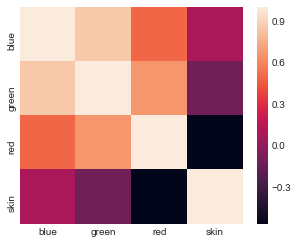

In [7]:
#Heatmap of correlation coefficients
corrcoef = X.corr()
rcParams['figure.figsize']=5, 4
sb.heatmap(corrcoef, xticklabels=corrcoef.columns.values, yticklabels=corrcoef.columns.values)

## Mean, Std

In [8]:
mx=X.mean()
stdx=X.std()

mx, stdx

(blue     125.065654
 green    132.507521
 red      123.177151
 skin       1.792464
 dtype: float64, blue     62.255694
 green    59.941243
 red      72.562313
 skin      0.405544
 dtype: float64)

## PCA

In [12]:
from IPython.display import Image
from IPython.core.display import HTML

import sklearn
from sklearn.decomposition import PCA
from sklearn import datasets
from sklearn import preprocessing
from matplotlib import pyplot as plt

#### PCA & Eigenvalues

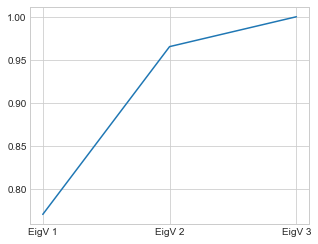

In [13]:
pca = PCA()
X_pca = pca.fit_transform(X)

np.set_printoptions(formatter={'float_kind':'{:f}'.format})
ev = pca.explained_variance_ratio_

cs = np.cumsum(ev)/sum(ev)
plt.plot(['EigV 1', 'EigV 2', 'EigV 3'], cs[:3])

#### Eigenvectors/Principal components

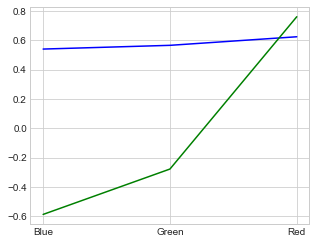

In [14]:
comps = pd.DataFrame(pca.components_,columns=X.columns)
plt.plot(['Blue', 'Green', 'Red'], pca.components_[0, :3], 'b', ['Blue', 'Green', 'Red'], pca.components_[1, :3], 'g')

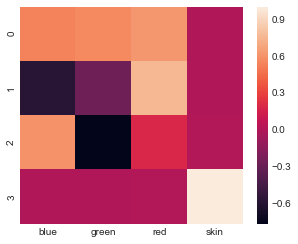

In [15]:
sb.heatmap(comps)

#### Projection of data on 2 main eigenvectors

In [16]:
from numpy import array

mu = X.mean(0)
#C = np.cov(X - mu, rowvar=False)
#d, u = np.linalg.eigh(C)
#U = u.T[::-1]
Z = np.dot(X - mu, comps[:2].T)

comps

,blue,green,red,skin
0,0.539844,0.565301,0.623700,-0.001107
1,-0.587251,-0.277913,0.760179,-0.005356
2,0.603069,-0.776659,0.181953,0.001406
3,-0.003395,0.000229,0.004507,0.999984


Text(0,0.5,'EigV 1')

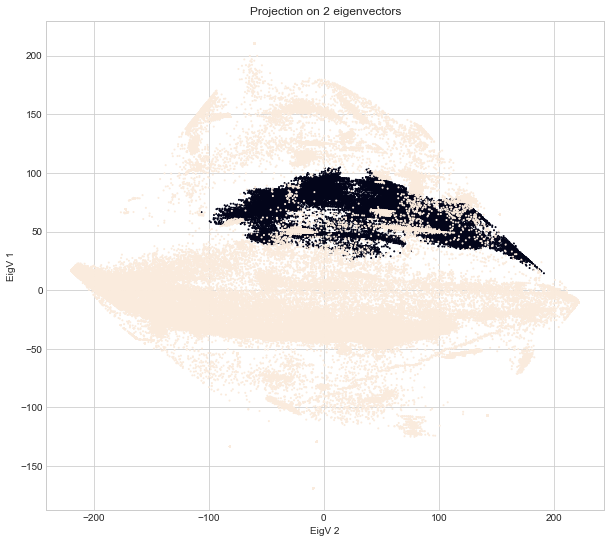

In [17]:
rcParams['figure.figsize']=10, 9
plt.scatter(Z[:, 0], Z[:, 1], c=X['skin'], s=1)
plt.title("Projection on 2 eigenvectors")
plt.xlabel("EigV 2")
plt.ylabel("EigV 1")

#### Reconstruction of the original data

Text(0,0.5,'Green')

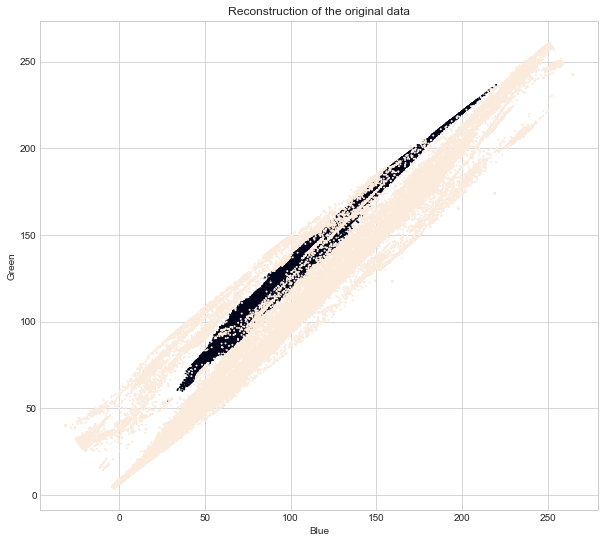

In [18]:
Xhat = np.dot(Z, pca.components_[:2,:2])
Xhat += [mu['blue'],mu['green']]
plt.scatter(Xhat[:, 0], Xhat[:, 1], c=X['skin'], s=1)
plt.title("Reconstruction of the original data")
plt.xlabel("Blue")
plt.ylabel("Green")

## Non-parametric classifier k-nearest neighbor on original vs PCA data

In [19]:
from sklearn.model_selection import train_test_split
from sklearn import neighbors
from sklearn import metrics
from sklearn.metrics import confusion_matrix

np.set_printoptions(precision=4,suppress = True)

In [20]:
Z2 = preprocessing.scale(X[['blue', 'green', 'red']])

X_train, X_test, y_train, y_test = train_test_split(Z2, X['skin'], test_size = .33, random_state=17)

Z3 = preprocessing.scale(Z)

X2_train, X2_test, y2_train, y2_test = train_test_split(Z3, X['skin'], test_size = .33, random_state=17)

In [21]:
#Original data
clf = neighbors.KNeighborsClassifier()
clf.fit(X_train, y_train)

y_expect = y_test
y_pred = clf.predict(X_test)

print(metrics.classification_report(y_expect, y_pred))
print(confusion_matrix(y_expect, y_pred))
knnc1 = metrics.accuracy_score(y_expect, y_pred)

             precision    recall  f1-score   support

          1       1.00      1.00      1.00     16688
          2       1.00      1.00      1.00     64181

avg / total       1.00      1.00      1.00     80869

[[16687     1]
 [   39 64142]]


In [22]:
#PCA data
clf = neighbors.KNeighborsClassifier()
clf.fit(X2_train, y2_train)

y_expect = y2_test
y_pred = clf.predict(X2_test)

print(metrics.classification_report(y_expect, y_pred))
print(confusion_matrix(y_expect, y_pred))
knnc2 = metrics.accuracy_score(y_expect, y_pred)

             precision    recall  f1-score   support

          1       0.97      0.99      0.98     16688
          2       1.00      0.99      1.00     64181

avg / total       0.99      0.99      0.99     80869

[[16516   172]
 [  434 63747]]


## Parametric classifier Quadratic Discriminant Analysis on original vs PCA data

In [23]:
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis, LinearDiscriminantAnalysis

In [24]:
#Original data
clf = QuadraticDiscriminantAnalysis()
clf.fit(X_train, y_train)

y_expect = y_test
y_pred = clf.predict(X_test)

print(metrics.classification_report(y_expect, y_pred))
print(confusion_matrix(y_expect, y_pred))
qdc1 = metrics.accuracy_score(y_expect, y_pred)

             precision    recall  f1-score   support

          1       0.99      0.92      0.96     16688
          2       0.98      1.00      0.99     64181

avg / total       0.98      0.98      0.98     80869

[[15434  1254]
 [  100 64081]]


In [25]:
#PCA data
clf = QuadraticDiscriminantAnalysis()
clf.fit(X2_train, y2_train)

y_expect = y2_test
y_pred = clf.predict(X2_test)

print(metrics.classification_report(y_expect, y_pred))
print(confusion_matrix(y_expect, y_pred))
qdc2 = metrics.accuracy_score(y_expect, y_pred)

             precision    recall  f1-score   support

          1       0.90      0.91      0.91     16688
          2       0.98      0.97      0.98     64181

avg / total       0.96      0.96      0.96     80869

[[15167  1521]
 [ 1632 62549]]


## Parametric classifier Linear Discriminant Analysis on original vs PCA data

In [26]:
#Original data
clf = LinearDiscriminantAnalysis()
clf.fit(X_train, y_train)

y_expect = y_test
y_pred = clf.predict(X_test)

print(metrics.classification_report(y_expect, y_pred))
print(confusion_matrix(y_expect, y_pred))
ldc1 = metrics.accuracy_score(y_expect, y_pred)

             precision    recall  f1-score   support

          1       0.79      0.90      0.84     16688
          2       0.97      0.94      0.96     64181

avg / total       0.94      0.93      0.93     80869

[[15063  1625]
 [ 4013 60168]]


In [29]:
#PCA data
clf = LinearDiscriminantAnalysis()
clf.fit(X2_train, y2_train)

y_expect = y2_test
y_pred = clf.predict(X2_test)

print(metrics.classification_report(y_expect, y_pred))
print(confusion_matrix(y_expect, y_pred))
ldc2 = metrics.accuracy_score(y_expect, y_pred)

             precision    recall  f1-score   support

          1       0.79      0.92      0.85     16688
          2       0.98      0.94      0.96     64181

avg / total       0.94      0.93      0.93     80869

[[15320  1368]
 [ 4035 60146]]


## Classifier accuracy plot

In [30]:
trace1 = go.Bar(
    x=['Knnc', 'Qdc', 'Ldc'],
    y=[knnc1*100, qdc1*100, ldc1*100],
    name='Original data'
)
trace2 = go.Bar(
    x=['Knnc', 'Qdc', 'Ldc'],
    y=[knnc2*100, qdc2*100, ldc2*100],
    name='PCA data'
)

data2 = [trace1, trace2]
layout = go.Layout(
    barmode='group'
)

fig = go.Figure(data=data2, layout=layout)

py.offline.init_notebook_mode()

py.offline.iplot(fig, image='png')